# 🎯 Base Model Training

This notebook implements the initial model training process for fraud detection, establishing a baseline performance using LightGBM.

## 📋 Key Components

1. **Data Preparation**
   - Load and preprocess training data
   - Handle missing values
   - Prepare feature sets

2. **Model Configuration**
   - Set up LightGBM parameters
   - Configure evaluation metrics
   - Define training parameters

3. **Training Process**
   - Train baseline model
   - Monitor training metrics
   - Evaluate model performance

4. **Model Evaluation**
   - Calculate performance metrics
   - Analyze feature importance
   - Generate evaluation plots

## 📚 Import Libraries

In [4]:
# Import core data manipulation and modeling libraries
import pandas as pd
import numpy as np
from lightgbm import LGBMClassifier
import sys
import pickle
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

# Add project root to Python path for importing custom modules
sys.path.append('../')

# Import custom utility classes for evaluation and reporting
from utils.eval_plots import EvalPlots
from utils.model_performance_report import ModelPerformanceReport

## 📥 Load and Prepare Data

In [6]:
# Load training data from parquet file
X = pd.read_parquet('../data/train_data.parquet')

# Define metadata columns to exclude from training
metadata_columns = ['trans_date_trans_time', 'gender', 'street']

# Separate features and target for training
train_y = X['is_fraud']
train_X = X.drop(columns=['is_fraud'] + metadata_columns)

# Load and prepare holdout dataset
holdout = pd.read_parquet('../data/holdout_data.parquet')
holdout_y = holdout['is_fraud']
holdout_X = holdout.drop(columns=['is_fraud'] + metadata_columns)

## 🎯 Standard Model Training

Training a baseline LightGBM model without any balancing or hyperparameter tuning to establish a performance baseline.

### Key Points:
- Uses default parameters
- No class balancing
- Helps identify overfitting patterns
- Serves as reference for improvements


Training overfit model (no tuning)...
[LightGBM] [Info] Number of positive: 6111, number of negative: 1055275
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003571 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2121
[LightGBM] [Info] Number of data points in the train set: 1061386, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.005758 -> initscore=-5.151466
[LightGBM] [Info] Start training from score -5.151466
Overfit Model Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00    263819
           1       0.75      0.73      0.74      1528

    accuracy                           1.00    265347
   macro avg       0.87      0.87      0.87    265347
weighted avg       1.00      1.00      1.00    265347



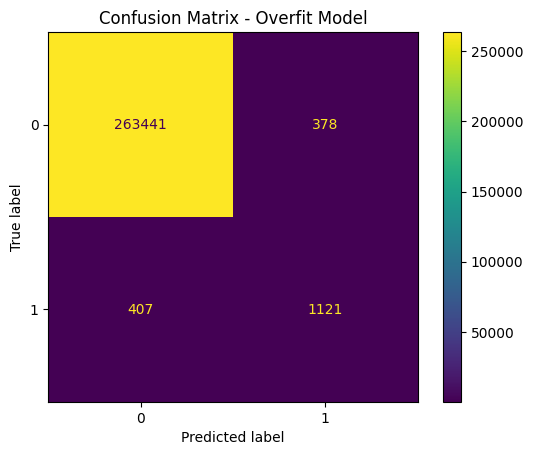

Overfit model training complete.


In [ ]:
print("\nTraining overfit model (no tuning)...")
# Overfitting model (no tuning, high complexity)

# Train baseline LightGBM model with default parameters
# Note: Using binary objective for fraud detection
score_standard_model = LGBMClassifier(objective='binary').fit(train_X, train_y)#, eval_metric='average_precision') 

# Save the trained model to disk for future use
with open('../models/score_standard_model.pkl', 'wb') as f:
    pickle.dump(score_standard_model, f)

y_pred_overfit = score_standard_model.predict(holdout_X)
print('Overfit Model Classification Report on holdout:')
print(classification_report(holdout_y, y_pred_overfit))

cm_overfit = confusion_matrix(holdout_y, y_pred_overfit)
disp_overfit = ConfusionMatrixDisplay(cm_overfit)
disp_overfit.plot()
plt.title('Confusion Matrix - Overfit Model')
plt.show()
print("Overfit model training complete.")

## 🔍 Quick evaluaton

In [11]:
# Load holdout and out-of-time datasets for evaluation
holdout = pd.read_parquet('../data/holdout_data.parquet')
oot = pd.read_parquet('../data/oot_data.parquet')

# Prepare feature sets for evaluation
holdout_X = holdout.drop(columns=['is_fraud'] + metadata_columns)[train_X.columns]
holdout_y = holdout['is_fraud']

oot_X = oot.drop(columns=['is_fraud'] + metadata_columns)[train_X.columns]
oot_y = oot['is_fraud']

In [12]:
# Initialize evaluation classes
report_class = ModelPerformanceReport(train_X, train_y, holdout_X, holdout_y, oot_X, oot_y)
eval_plots = EvalPlots()

In [13]:
# nr of iterations
score_standard_model.n_iter_

100

In [14]:
# Generate report
report_class.produce_report(score_standard_model)

,train,holdout,oot
accuracy,0.997803,0.997042,0.996355
precision,0.850232,0.747832,0.518209
recall,0.750614,0.733639,0.678926
f1,0.797323,0.740667,0.587780


In [15]:
# Generate predictions for all datasets
y_train_pred, y_train_true, y_holdout_pred, y_holdout_true, y_oot_true, y_oot_pred = report_class.predictions(score_standard_model)

In [16]:
# Generate and display evaluation plots
report_class.plot_eval_pred_dist(y_train_true, y_train_pred, y_holdout_true, y_holdout_pred, y_oot_true, y_oot_pred)


In [17]:

# Generate precision-recall AUC report
report_class.produce_pr_auc_report(score_standard_model)

## 📊 Model Performance Analysis

### Key Observations:
- Model performance across different datasets
- Distribution of predictions
- Precision-Recall analysis
- Overfitting indicators

## 🤔 Model Considerations

### Identified Issues:
1. **Overfitting Indicators**
   - Significant performance gap between training and validation
   - Poor generalization to holdout and OOT sets

2. **Potential Root Causes**
   - Class imbalance not addressed
   - Hyperparameters not optimized
   - Feature engineering limitations

3. **Next Steps**
   - Implement class balancing (see notebook 02b)
   - Perform hyperparameter tuning
   - Enhance feature engineering